# Introduction

> A quick overview of some features of [TorchIO](https://torchio.readthedocs.io/), exemplified using data from the [Medical Segmentation Decathlon](http://medicaldecathlon.com/). 

The notebook is based on [data_preprocessing_and_augmentation_using_TorchIO_a_tutorial.ipynb](https://colab.research.google.com/github/fepegar/torchio-notebooks/blob/main/notebooks/Data_preprocessing_and_augmentation_using_TorchIO_a_tutorial.ipynb#scrollTo=o1n9zCh7CYWg) [Colab link]

The notebook illustrates the concept of **data augmentation**, and the importance of **domain knowledge** and **domain-specific** deep learning setups. We'll do this by using a library called [TorchIO](https://torchio.readthedocs.io/), designed for 3D medical imaging, and data from the Medical Segmentation Decathlon, downloaded in the previous notebook. 

First, we'll illustrate a first step when faced with a new image data set: look at tons of examples from the training set and perform some exploratory data analysis. Among other things, this can give you ideas about what kind of data augmentation you should use. Next, we'll have a look at some data augmentation methods tailored for this kind of data (see the accompanying lecture slides for additional details).

# Setup

In [1]:
# This is a quick check of whether the notebook is currently running on Google Colaboratory, 
# as that makes some difference for the code below.
try:
    import colab
    colab=True
except:
    colab=False

In [2]:
if colab:
    !python -c "import monai" || pip install -q "monai[all]"
    !python -c "import matplotlib" || pip install -q matplotlib
    !pip install fastcore
    !pip install torchio

In [3]:
%matplotlib inline
import numpy as np, pandas as pd, matplotlib.pyplot as plt
from pathlib import Path
from glob import glob
from pprint import pprint
from scipy import stats
from tqdm import tqdm

from fastcore.utils import *

import torch
import torchio as tio
from torch.utils.data import DataLoader
import monai

/home/alex/anaconda3/envs/monai/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [4]:
NB_DIR = Path.cwd()

In [5]:
if colab:
    from google.colab import drive
    drive.mount("/content/gdrive")
    DATA = Path("/content/gdrive/MyDrive/Colab Notebooks/data/brats/MONAI/Task01_BrainTumour/imagesTr")
else:
    # Point this to where you want data stored
    DATA = Path.home()/'data-tmp'/'brats'/'MONAI'/'Task01_BrainTumour'/'imagesTr'

DATA.mkdir(exist_ok=True, parents=True)

# Load data

In [6]:
DATA.ls()

(#496) [Path('/home/alex/data-tmp/brats/MONAI/Task01_BrainTumour/imagesTr/BRATS_061.nii.gz'),Path('/home/alex/data-tmp/brats/MONAI/Task01_BrainTumour/imagesTr/BRATS_465.nii.gz'),Path('/home/alex/data-tmp/brats/MONAI/Task01_BrainTumour/imagesTr/BRATS_333.nii.gz'),Path('/home/alex/data-tmp/brats/MONAI/Task01_BrainTumour/imagesTr/BRATS_321.nii.gz'),Path('/home/alex/data-tmp/brats/MONAI/Task01_BrainTumour/imagesTr/BRATS_247.nii.gz'),Path('/home/alex/data-tmp/brats/MONAI/Task01_BrainTumour/imagesTr/BRATS_351.nii.gz'),Path('/home/alex/data-tmp/brats/MONAI/Task01_BrainTumour/imagesTr/BRATS_137.nii.gz'),Path('/home/alex/data-tmp/brats/MONAI/Task01_BrainTumour/imagesTr/BRATS_231.nii.gz'),Path('/home/alex/data-tmp/brats/MONAI/Task01_BrainTumour/imagesTr/BRATS_211.nii.gz'),Path('/home/alex/data-tmp/brats/MONAI/Task01_BrainTumour/imagesTr/._BRATS_274.nii.gz')...]

Load all subject directories:

In [7]:
subjects = sorted([s.split(".")[0].split("/")[-1] for s in glob(str(DATA) + '/*.nii.gz')])

In [8]:
len(subjects), subjects[:5]

(484, ['BRATS_001', 'BRATS_002', 'BRATS_003', 'BRATS_004', 'BRATS_005'])

# Explore the BraTS2020 data set

## Tumor volumes

Goal: get an overview of the heterogeneity of the tumor volumes in the training data set.

In [9]:
test_subject = subjects[0]
test_subject

'BRATS_001'

In [10]:
def get_sub(subject):
    mri = f'{DATA/subject}.nii.gz'
    seg = f"{DATA/'..'/'labelsTr'/subject}.nii.gz"
    sub = tio.Subject(
            mri=tio.ScalarImage(mri, channels_last=True),
            seg=tio.LabelMap(seg)
    )
    return sub

In [11]:
sub = get_sub(test_subject)

print(sub)
print(sub.mri)
print(sub.seg)

Subject(Keys: ('mri', 'seg'); images: 2)
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: RAS+; path: "/home/alex/data-tmp/brats/MONAI/Task01_BrainTumour/imagesTr/BRATS_001.nii.gz")
LabelMap(shape: (1, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: RAS+; path: "/home/alex/data-tmp/brats/MONAI/Task01_BrainTumour/imagesTr/../labelsTr/BRATS_001.nii.gz")


In [12]:
def get_tumor_percentage(subject_dir):
    sub = get_sub(subject_dir)
    seg_nonzero = np.sum(sub.seg.numpy()[0,::].nonzero())
    mri_nonzero = np.sum(sub.mri.numpy()[1,::].nonzero())
    return (seg_nonzero*100/mri_nonzero)

In [13]:
get_tumor_percentage(test_subject)

8.457377388401264

BRATS_001. Tumor percentage: 8.45738


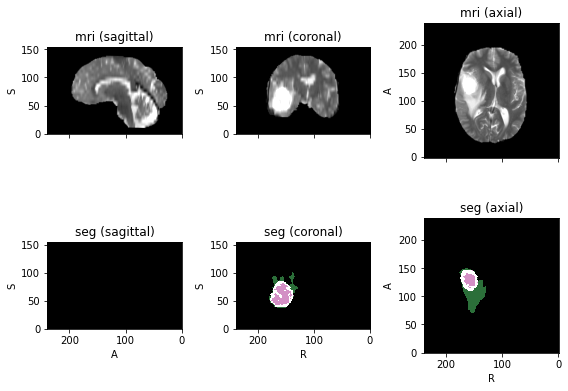

########################################
BRATS_002. Tumor percentage: 3.55713


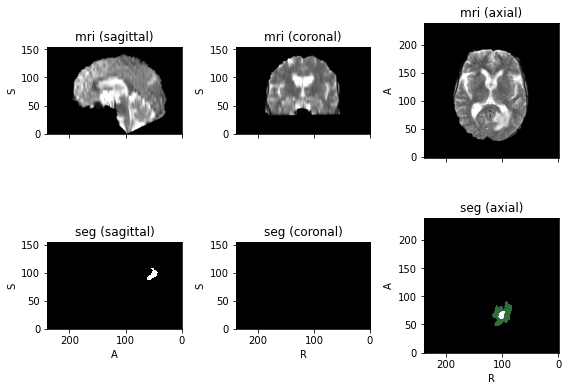

########################################
BRATS_003. Tumor percentage: 10.31182


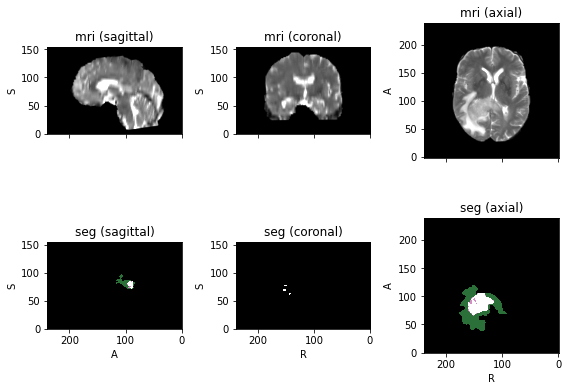

########################################
BRATS_004. Tumor percentage: 9.60965


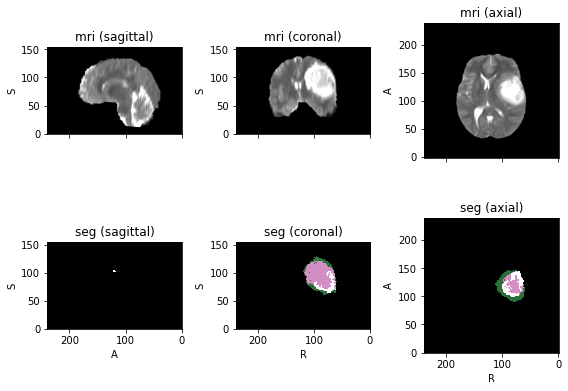

########################################
BRATS_005. Tumor percentage: 5.6284


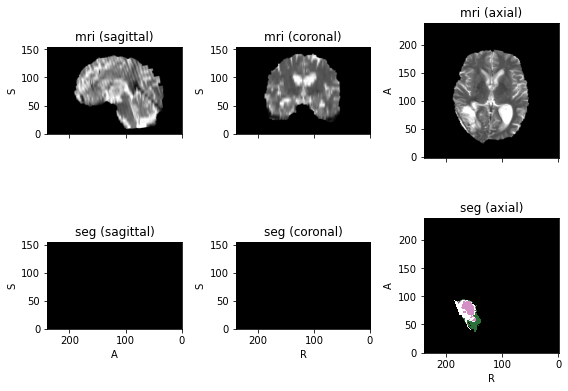

########################################
BRATS_006. Tumor percentage: 14.92528


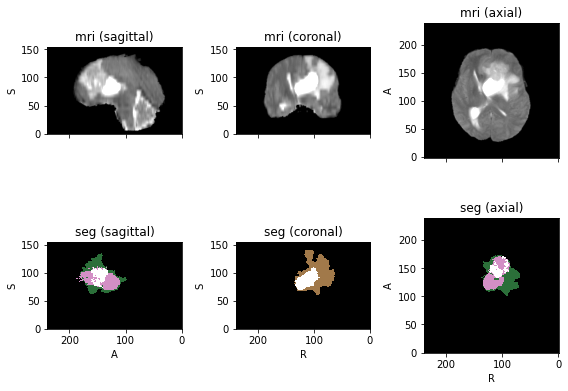

########################################
BRATS_007. Tumor percentage: 4.24424


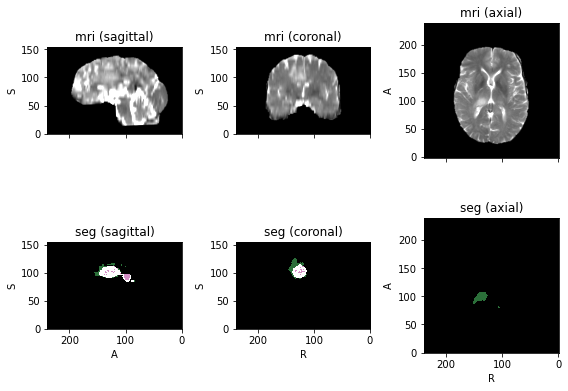

########################################
BRATS_008. Tumor percentage: 11.7294


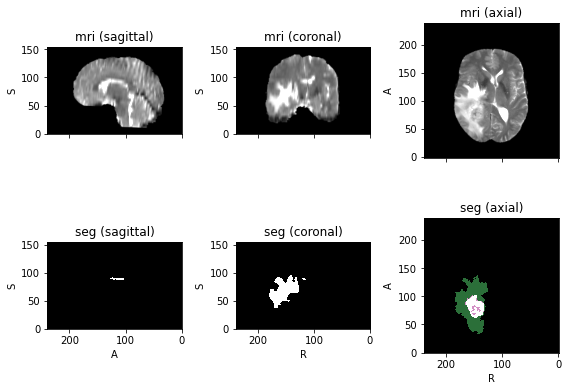

########################################


In [14]:
for s in subjects[:8]:
    sub = get_sub(s)
    print(f"{s}. Tumor percentage: {get_tumor_percentage(s).round(5)}")
    sub.plot(figsize=(8,8))
    print("#"*40)

In [15]:
# Make a small random sample (to speed up the computation)
import random
volumes = [get_tumor_percentage(s) for s in random.choices(subjects, k=100)]

In [16]:
len(volumes)

100

In [17]:
print(f"Min: {np.min(volumes)}%. Subject: {np.argmin(volumes)}, {subjects[np.argmin(volumes)]}")
print(f"Mean: {np.min(volumes)}%")
print(f"Median: {np.median(volumes)}%")
print(f"Max: {np.max(volumes)}%. Subject: {np.argmax(volumes)}, {subjects[np.argmax(volumes)]}")

Min: 0.8022909895729411%. Subject: 22, BRATS_023
Mean: 0.8022909895729411%
Median: 7.845116854461528%
Max: 19.527500245091762%. Subject: 93, BRATS_094


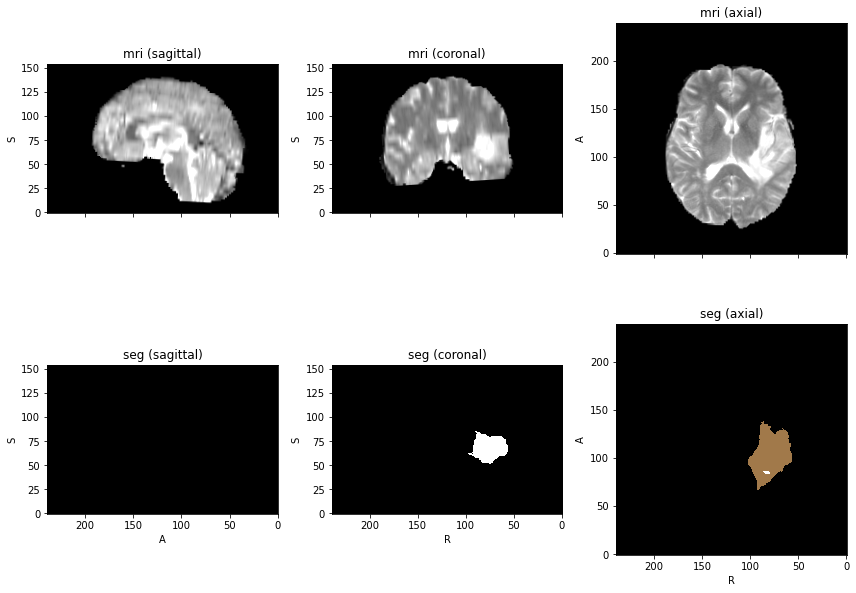

In [18]:
# Smallest tumor in the sample
sub = get_sub(subjects[np.argmin(volumes)])
sub.plot(figsize=(12,12))

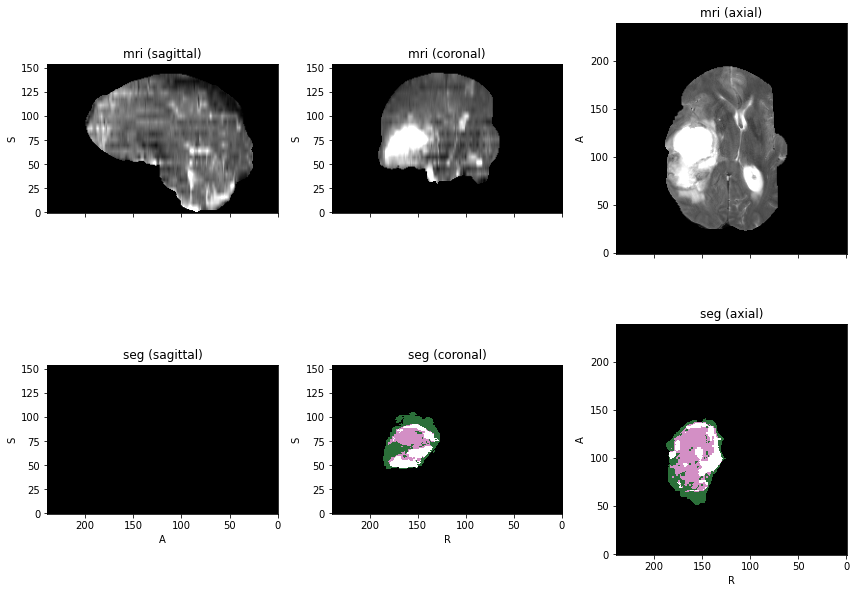

In [19]:
# Largest tumor in the sample
sub = get_sub(subjects[np.argmax(volumes)])
sub.plot(figsize=(12,12))

In [20]:
import seaborn as sns

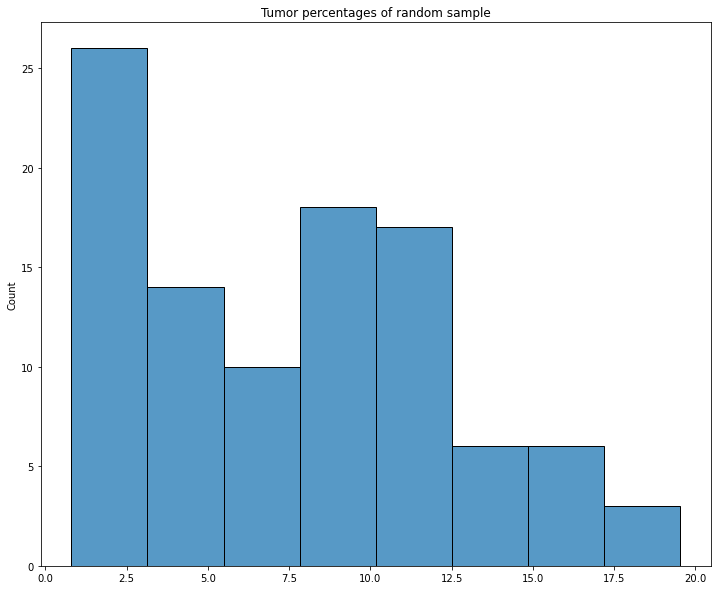

In [21]:
plt.figure(figsize=(12,10))
sns.histplot(volumes)
plt.title('Tumor percentages of random sample')
plt.savefig('tumor_percentages_histogram.png')
plt.show()

## Make a GIF of some images

In [22]:
import PIL

In [23]:
GIF = DATA/'brats-training-data-gif'
GIF.mkdir(exist_ok=True)

In [24]:
gif_out = GIF/"example_images.gif"

In [25]:
run=True

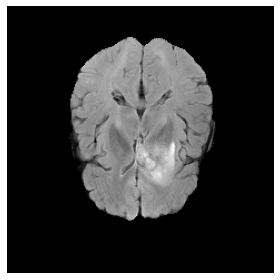

In [26]:
if run:
    for s in random.choices(subjects, k=32):
        sub = get_sub(s)
        shape = sub.mri.shape
        plt.imshow(sub.mri.data[0,:,:,shape[-1]//2].rot90().flipud(), cmap='gray')
        plt.axis('off')
        plt.tight_layout()
        plt.savefig(f"{GIF/s}.png")

In [27]:
if run: 
    img, *imgs = [PIL.Image.open(f) for f in sorted(GIF.glob('*.png'))]
    img.save(fp=gif_out, format='GIF', append_images=imgs,
             save_all=True, duration=500, loop=1)

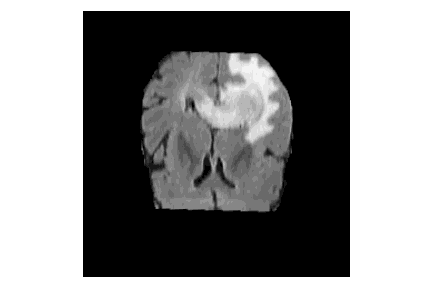

In [28]:
from IPython.display import Image
Image(filename=GIF/gif_out)

## Make a collage of some images

**All the above slices:**

In [30]:
pngdir = str(GIF)

In [31]:
if run:
    !montage -geometry 600x600-160-140 $pngdir/B*.png miff:- | convert miff:- -resize 4096x4096 $pngdir/montage.png

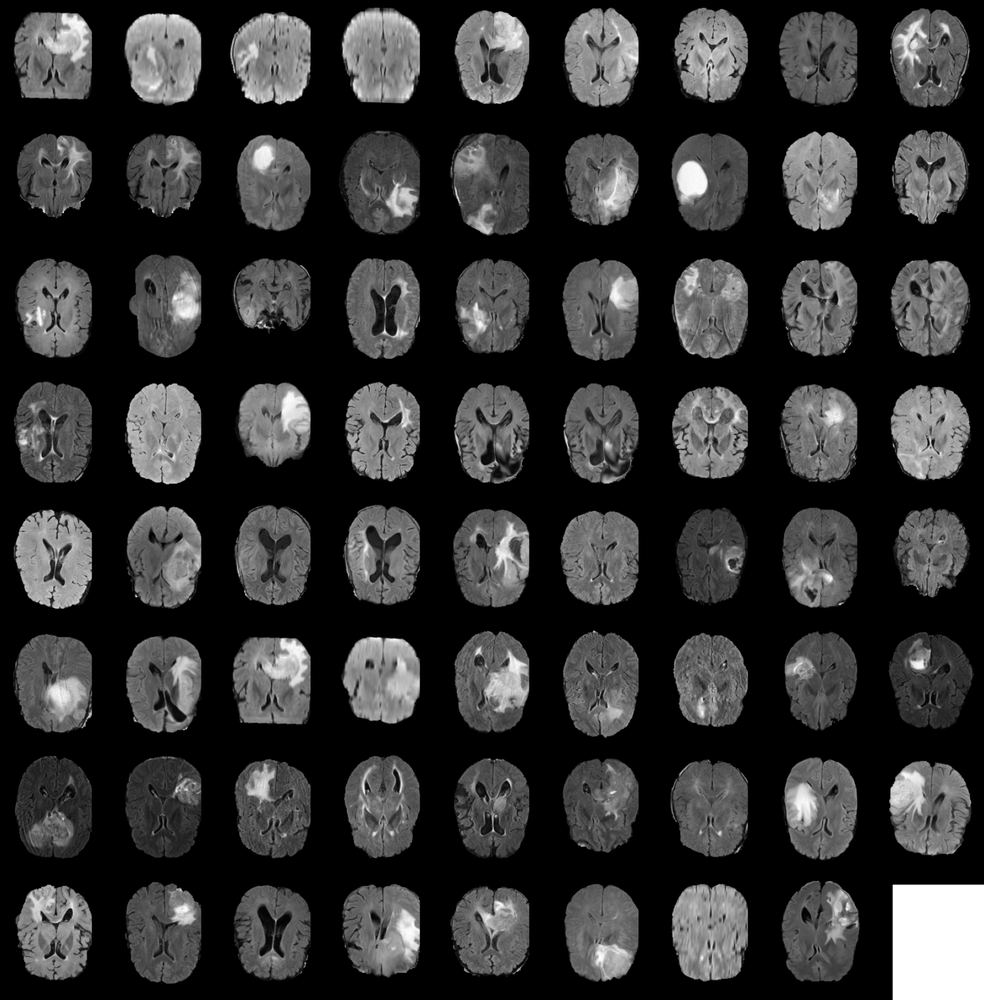

In [33]:
Image(filename=GIF/'montage.png')

# TorchIO

Create a list of `tio.Subject`'s from all the BraTS2020 training subjects.

In [35]:
tio_subjects = [get_sub(s) for s in subjects]

In [36]:
dataset = tio.SubjectsDataset(tio_subjects)

In [37]:
print(f'Dataset size: {len(dataset)} subjects')

Dataset size: 484 subjects


Check a sample data set:

In [38]:
i=0

print(dataset[i])
print(dataset[i].mri)
print(dataset[i].seg)

Subject(Keys: ('mri', 'seg'); images: 2)
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: RAS+; dtype: torch.FloatTensor; memory: 136.2 MiB)
LabelMap(shape: (1, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: RAS+; dtype: torch.ByteTensor; memory: 8.5 MiB)


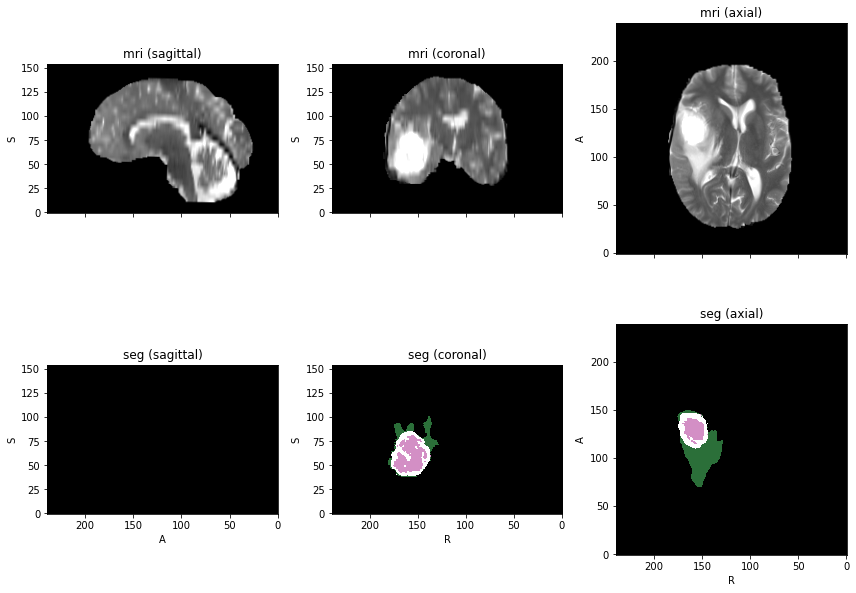

In [39]:
dataset[i].plot(figsize=(12,12))

# Transformations

Test some TorchIO transformations.

In [40]:
# Helper functions to make plots of transformed data

def plot_transform(pretransform, transformed, orient='S', figsize=(12,12)):
    """
    Input:
        pretransform: a set of tio images
        transformed: the result of applying a transformation
        k: perform this many transformations at random
        orient: if k > 1, this gives the orientation in which to plot 
                the transformation results
        
    If k > 1 the output is a mosaic plot of the results from all k transformations,
    plotted in the orientation given by `orient`
    """
    
    if len(transformed)!=1:
        print(f"Pre-transform:")
        print(pretransform.mri)
        pretransform.plot(figsize=figsize)

        print(f"After transformation:")
        try: 
            print(transformed.mri)
        except:
            print(transformed)
        try: 
            transformed.plot(figsize=figsize)
        except:
            transformed.plot()
    elif k>1:
        transformed = []

def plot_k_transformed(pretransform, transformed, orient='S', figsize=(12,12)):
    """
    Input:
        pretransform: a set of tio images
        transformed: the result of applying a transformation multiple times to pretransform
        orient: slice orientation in which to plot the transformation results
    """

    all_images = [pretransform, ] + transformed
    
    k = len(all_images)
    
    nrows = int(np.sqrt(k))
    ncols = int(np.sqrt(k))
    
    f, ax = plt.subplots(nrows=nrows,ncols=ncols, figsize=figsize, sharex=True, sharey=True)
    
    for i, axi in enumerate(ax.flat):
        image = all_images[i]
        sh = image.mri.data.shape
        image_data = image.mri.data
        axi.imshow(image_data[0, :,:,sh[-1]//2].rot90(), cmap='gray')
        rowid = i // ncols
        columnid = i % ncols
        axi.set_title("Row:"+str(rowid)+", Col:"+str(columnid))
        
    ax[0,0].set_title('Original')

In [41]:
sample = dataset[0]

Pre-transform:
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: RAS+; dtype: torch.FloatTensor; memory: 136.2 MiB)


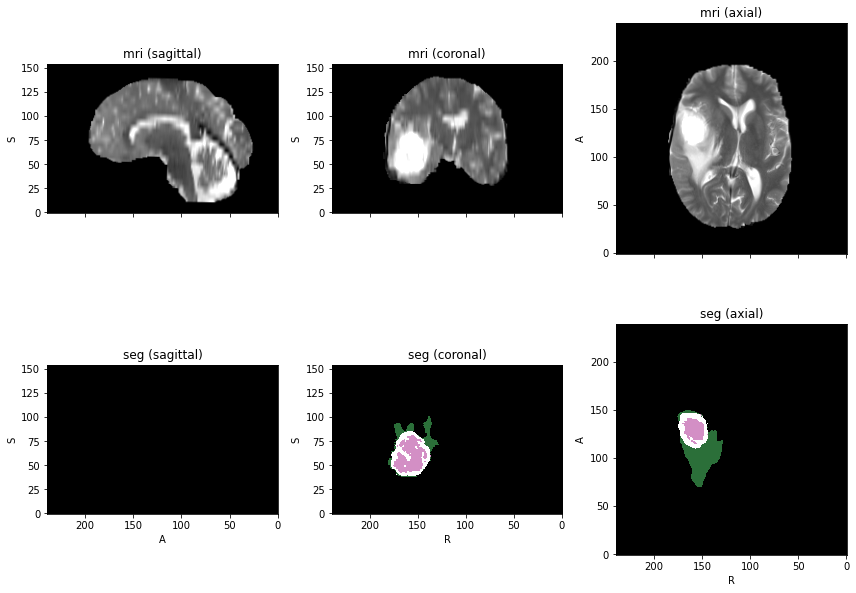

After transformation:
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: RAS+; dtype: torch.FloatTensor; memory: 136.2 MiB)


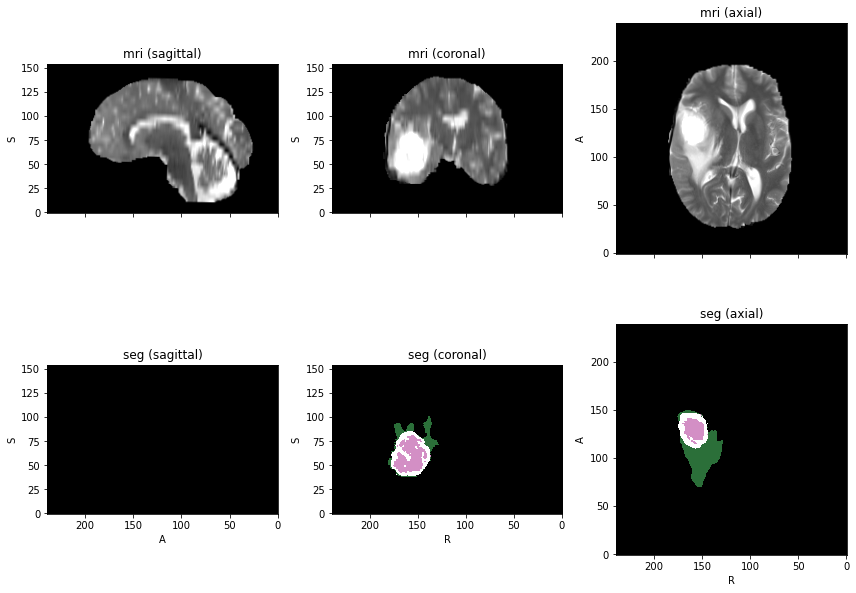

In [42]:
plot_transform(sample, sample)

## Resample

We can use `tio.Resample` to modify the voxel spacing. Can be used to obtain e.g. 1x1x1 voxels, or perhaps resample to a lower resolution by increasing the voxel spacing (to save memory or as part of a data augmentation setup mimicing that the data seen by a model may have been upsampled from a low resolution. See "RandomAnisotropy" below).

In [43]:
#?tio.Resample

In [44]:
downsampling_factor = 3
original_spacing = 1
target_spacing = downsampling_factor / original_spacing  # in mm
downsample = tio.Resample(target_spacing)
downsampled = downsample(sample)
print('Original image:', sample.mri)
print('Downsampled image:', downsampled.mri)

Original image: ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: RAS+; dtype: torch.FloatTensor; memory: 136.2 MiB)
Downsampled image: ScalarImage(shape: (4, 80, 80, 52); spacing: (3.00, 3.00, 3.00); orientation: RAS+; dtype: torch.FloatTensor; memory: 5.1 MiB)


In [45]:
print(f'The downsampled image takes {sample.mri.memory / downsampled.mri.memory:.1f} times less memory!')

The downsampled image takes 26.8 times less memory!


Pre-transform:
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: RAS+; dtype: torch.FloatTensor; memory: 136.2 MiB)


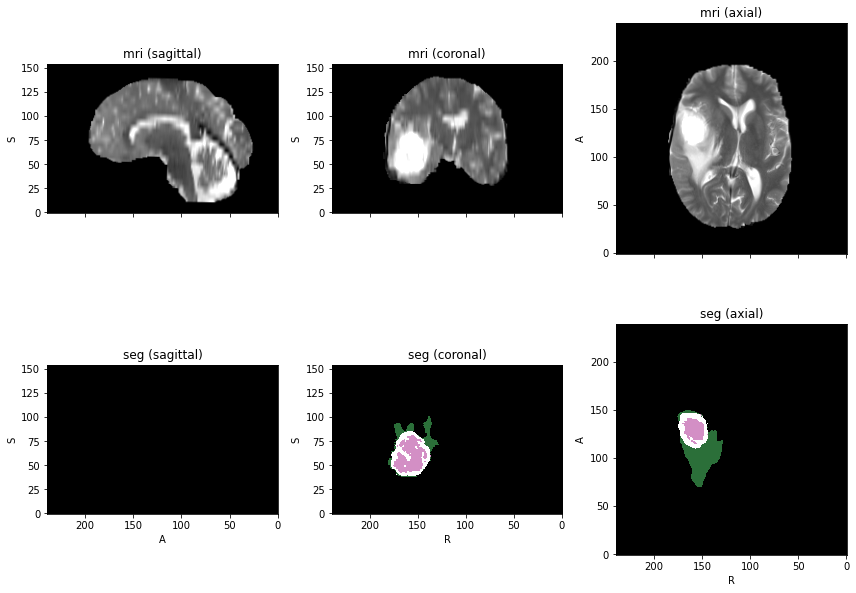

After transformation:
ScalarImage(shape: (4, 80, 80, 52); spacing: (3.00, 3.00, 3.00); orientation: RAS+; dtype: torch.FloatTensor; memory: 5.1 MiB)


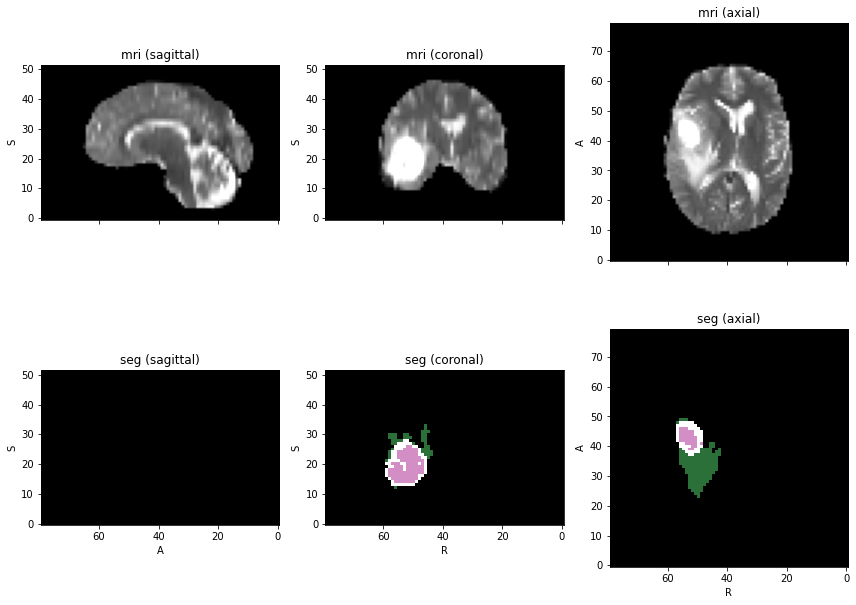

In [46]:
plot_transform(sample, downsampled)

Can add blurring to the result:

In [47]:
original_spacing = 1
std = tio.Resample.get_sigma(downsampling_factor, original_spacing)
antialiasing = tio.Blur(std)  # we need don't need a random transform here
blurry = antialiasing(sample)
downsampled_antialiasing = downsample(blurry)

Pre-transform:
ScalarImage(shape: (4, 80, 80, 52); spacing: (3.00, 3.00, 3.00); orientation: RAS+; dtype: torch.FloatTensor; memory: 5.1 MiB)


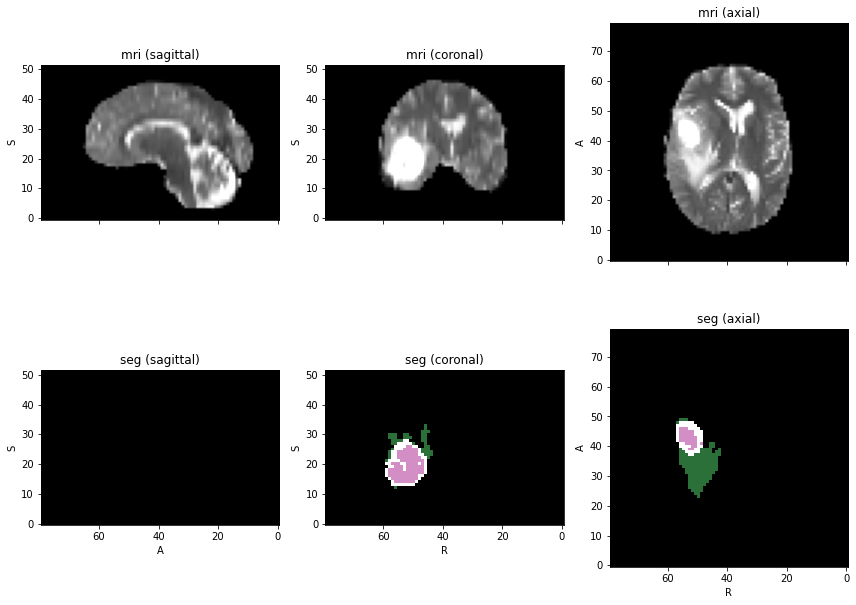

After transformation:
ScalarImage(shape: (4, 80, 80, 52); spacing: (3.00, 3.00, 3.00); orientation: RAS+; dtype: torch.FloatTensor; memory: 5.1 MiB)


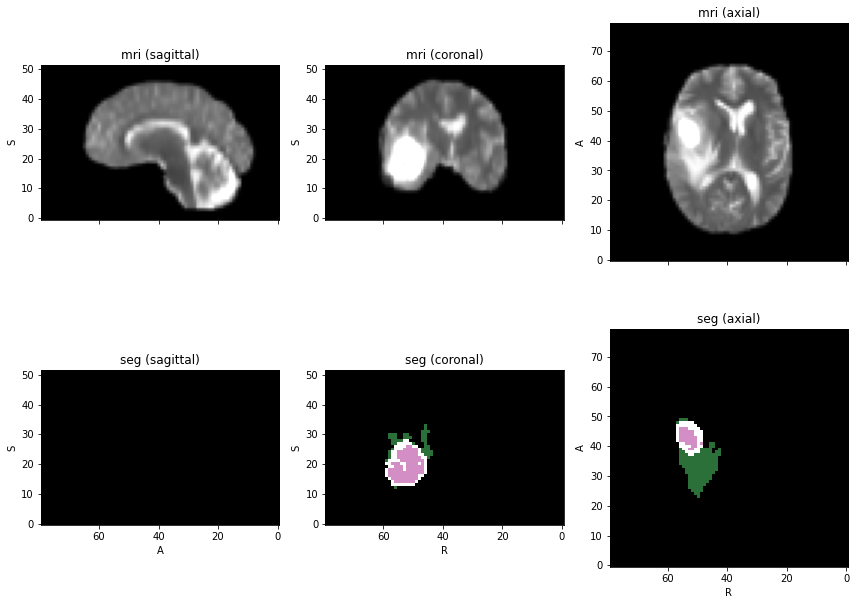

In [48]:
plot_transform(downsampled, downsampled_antialiasing)

## Random anisotropy

In [49]:
#?tio.RandomAnisotropy

In [50]:
random_anisotropy = tio.RandomAnisotropy()
sample_anisotropic = random_anisotropy(sample)

In [51]:
print('Applied transforms:')
pprint(sample_anisotropic.history)

Applied transforms:
[Resample(target=(1.0, 1.0, 4.01865291595459), image_interpolation=nearest, label_interpolation=nearest, pre_affine_name=None, scalars_only=True),
 Resample(target=((240, 240, 155), array([[1., 0., 0., 0.],
       [0., 1., 0., 0.],
       [0., 0., 1., 0.],
       [0., 0., 0., 1.]])), image_interpolation=linear, label_interpolation=nearest, pre_affine_name=None, scalars_only=True)]


Pre-transform:
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: RAS+; dtype: torch.FloatTensor; memory: 136.2 MiB)


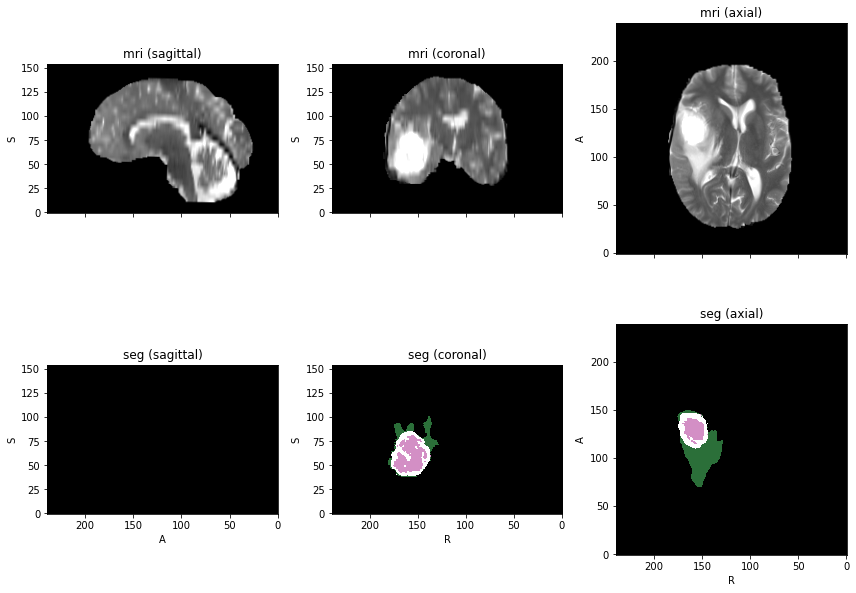

After transformation:
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: RAS+; dtype: torch.FloatTensor; memory: 136.2 MiB)


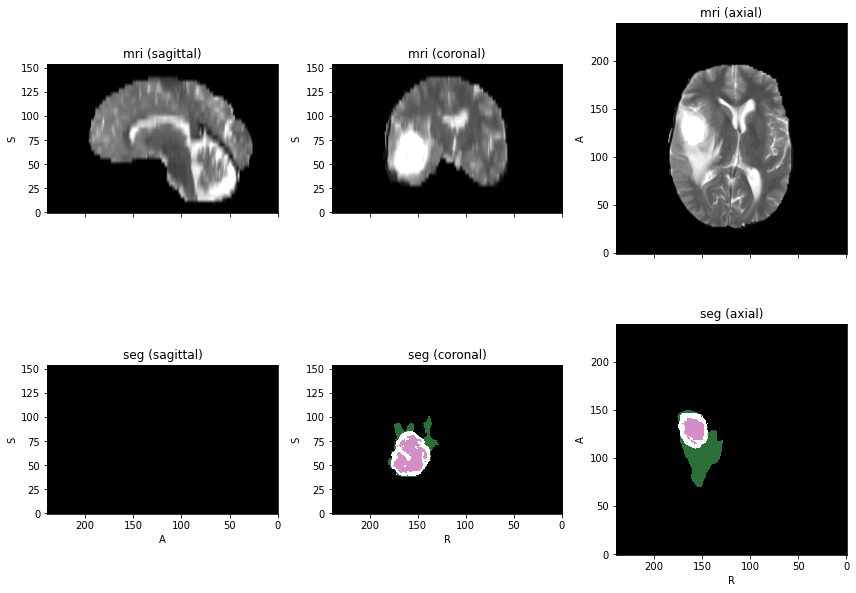

In [52]:
plot_transform(sample, sample_anisotropic)

## Random affine

One can apply random affine transformations, including zooming:

In [132]:
random_affine = tio.RandomAffine(scales=(1.5, 1.5))
sample_affine = random_affine(sample)

Pre-transform:
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: RAS+; memory: 136.2 MiB; dtype: torch.FloatTensor)


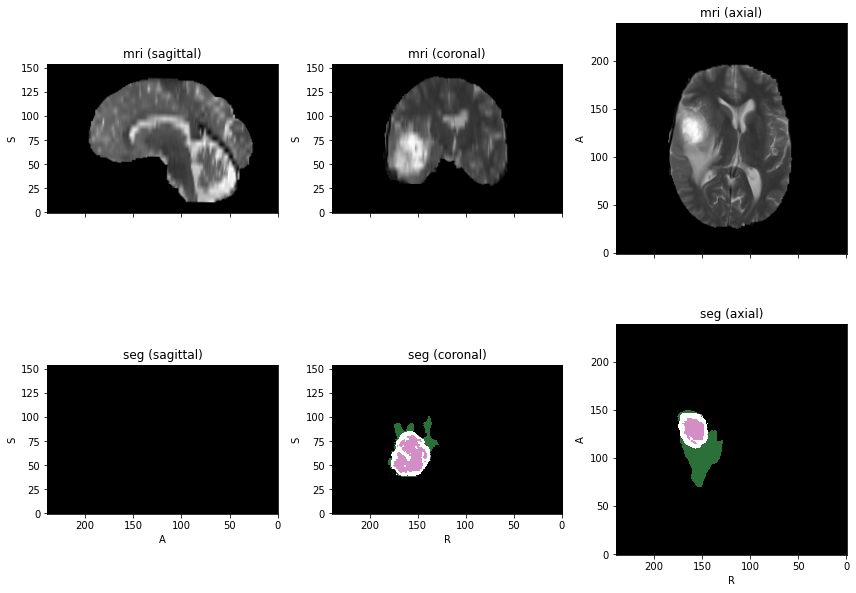

After transformation:
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: RAS+; memory: 136.2 MiB; dtype: torch.FloatTensor)


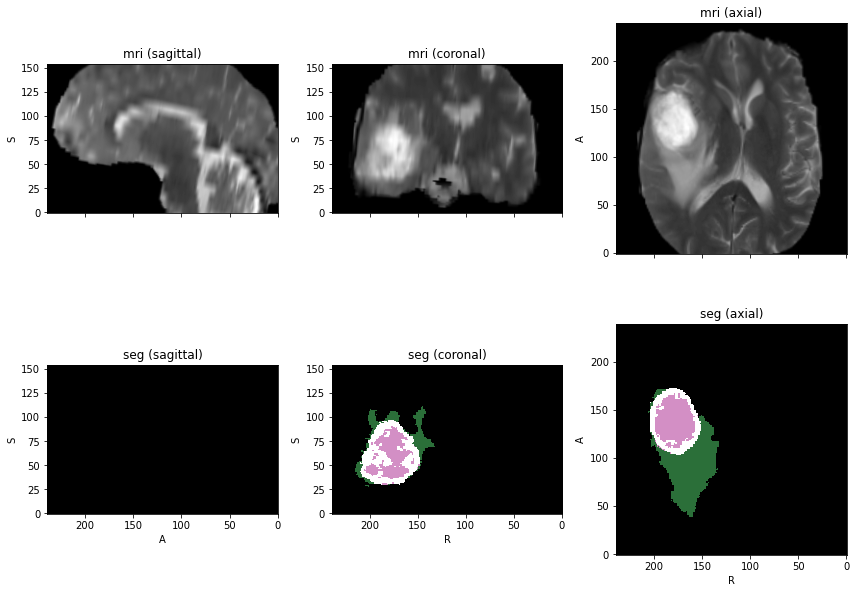

In [133]:
plot_transform(sample, sample_affine)

Here are a few examples:

In [134]:
k=15
affines = []
for i in range(k):
    random_affine = tio.RandomAffine(scales=(1.01, 1.01))
    affines.append(random_affine(sample))

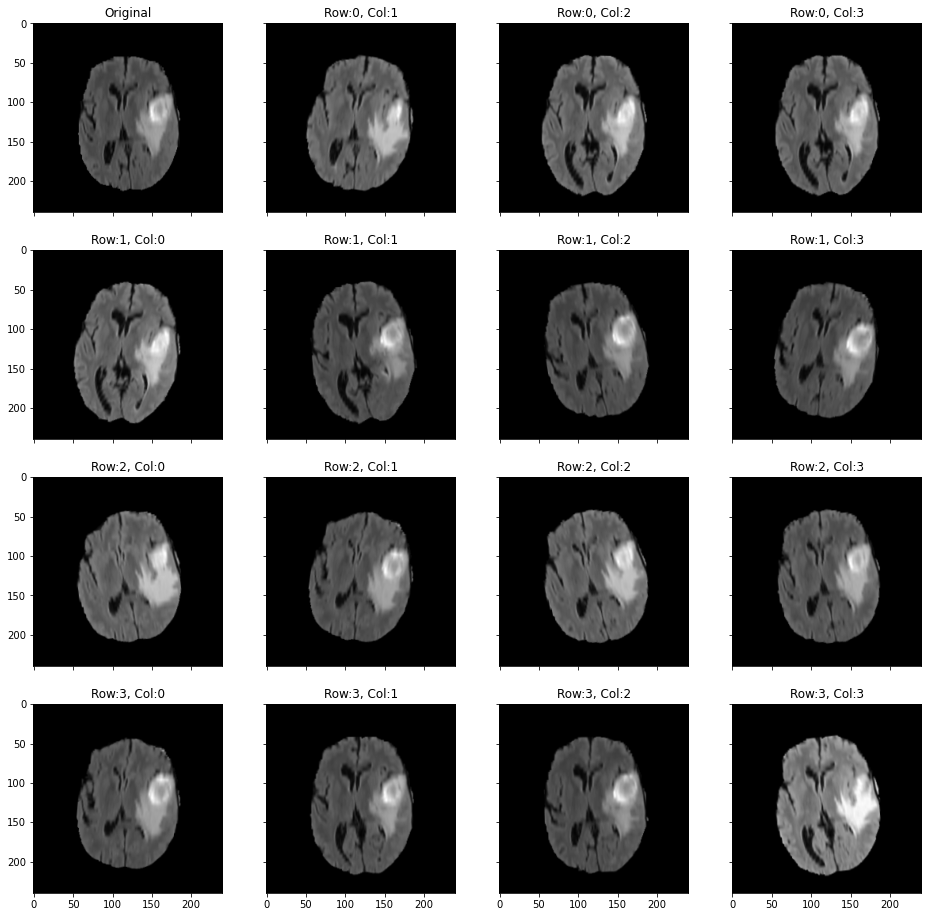

In [135]:
plot_k_transformed(sample, affines, figsize=(16,16))

## Random elastic deformation

Here's something more interesting: random elastic deformations:

In [72]:
max_displacement = 40, 20, 0  # in x, y and z directions
random_elastic = tio.RandomElasticDeformation(max_displacement=max_displacement)
sample_elastic = random_elastic(sample)

The maximum displacement is larger than the coarse grid spacing for dimensions: [0], so folding may occur. Choose fewer control points or a smaller maximum displacement


Pre-transform:
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: LPS+; memory: 68.1 MiB; dtype: torch.ShortTensor)


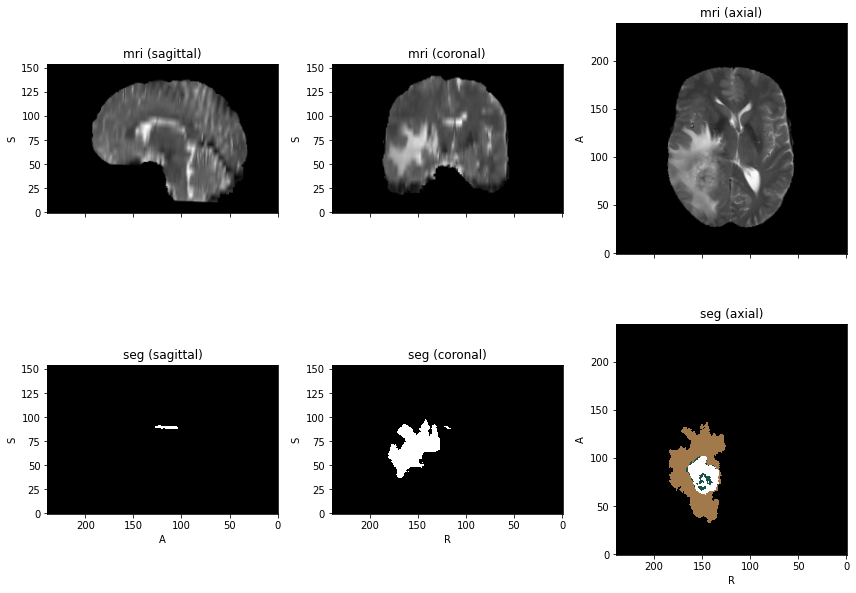

After transformation:
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: LPS+; memory: 136.2 MiB; dtype: torch.FloatTensor)


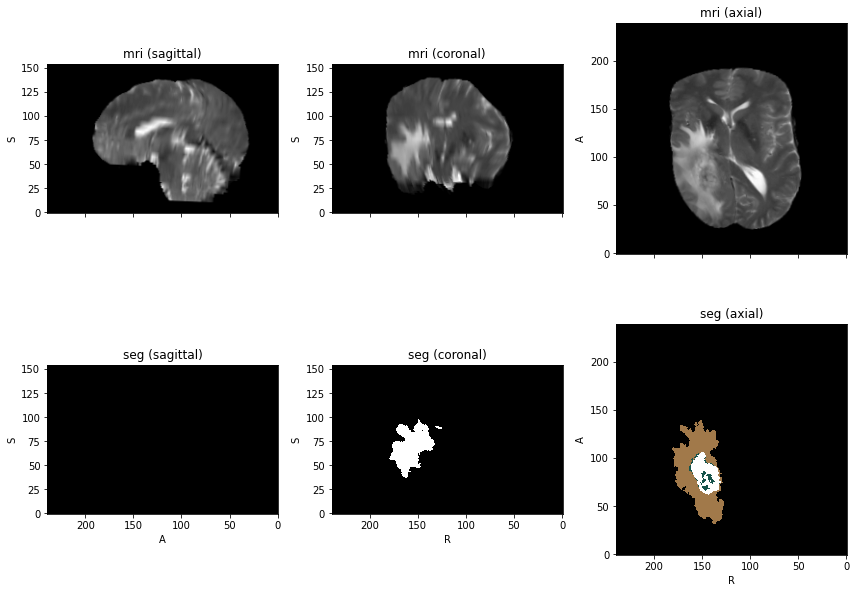

In [73]:
plot_transform(sample, sample_elastic)

> IDEA: Add elastic deformations centered on the tumors. See also the addition of cavities in healthy brains explained below. 

In [75]:
#??tio.RandomElasticDeformation

## Intensity rescaling

## Normalization

> IDEA: Try multiple normalization techniques in a grid search CV setup

### Normalization 1: Intensity rescaling

### Normalization 2: Z-standardization using the foreground

### Normalization 3: Histogram normalization using landmarks

## Random blurring

In [61]:
blur = tio.RandomBlur()
blurred = blur(sample)

Pre-transform:
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: LPS+; memory: 136.2 MiB; dtype: torch.FloatTensor)


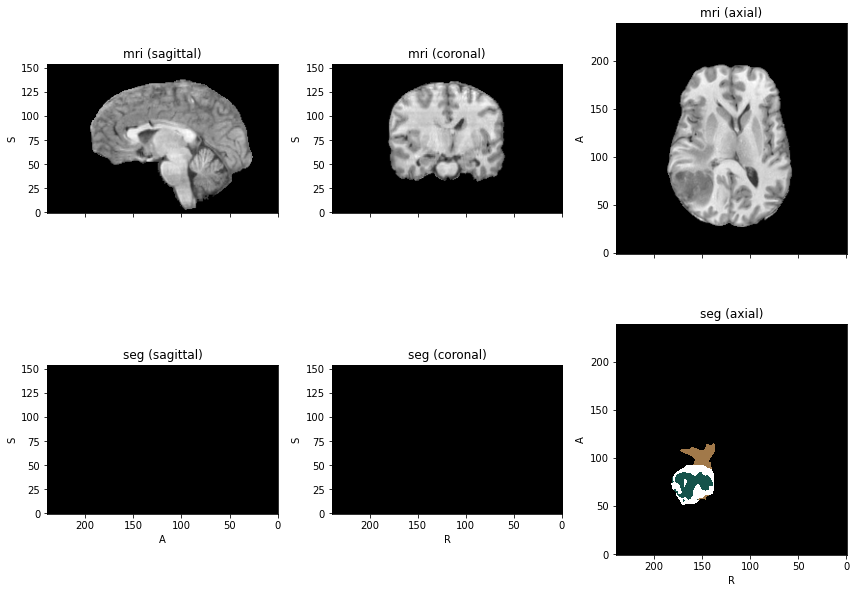

After transformation:
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: LPS+; memory: 136.2 MiB; dtype: torch.FloatTensor)


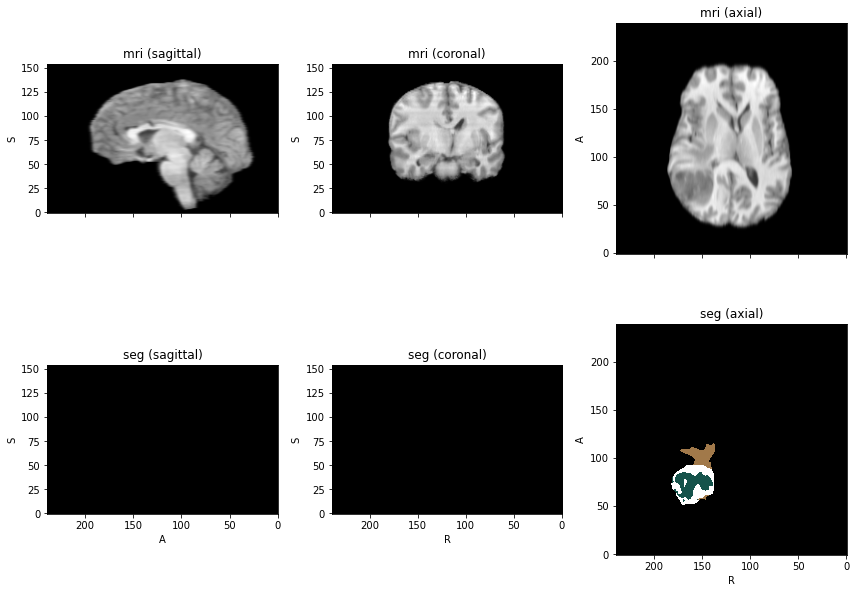

In [62]:
plot_transform(sample, blurred)

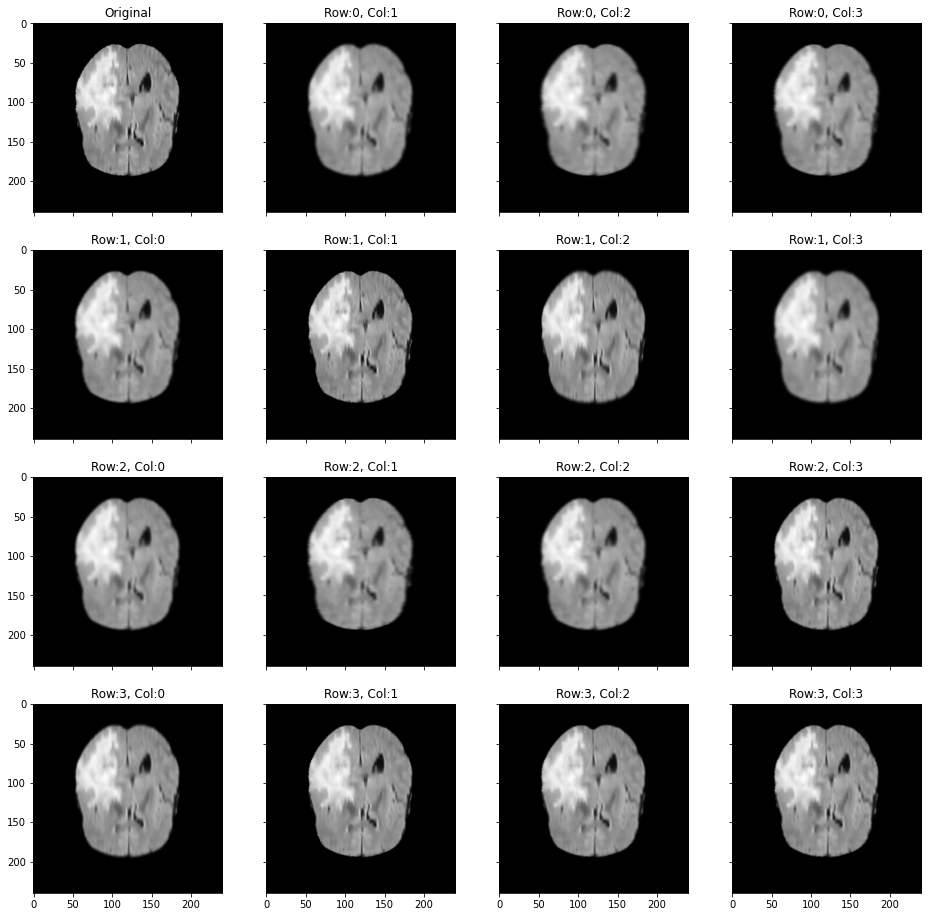

In [80]:
k=15
blurred = []
for i in range(k):
    random_blur = tio.RandomBlur()
    blurred.append(random_blur(sample))

plot_k_transformed(sample, blurred, figsize=(16,16))

## Random noise

In [78]:
standardize = tio.ZNormalization()

In [79]:
add_noise = tio.RandomNoise(std=0.5)
standard = standardize(sample)
noisy = add_noise(standard)

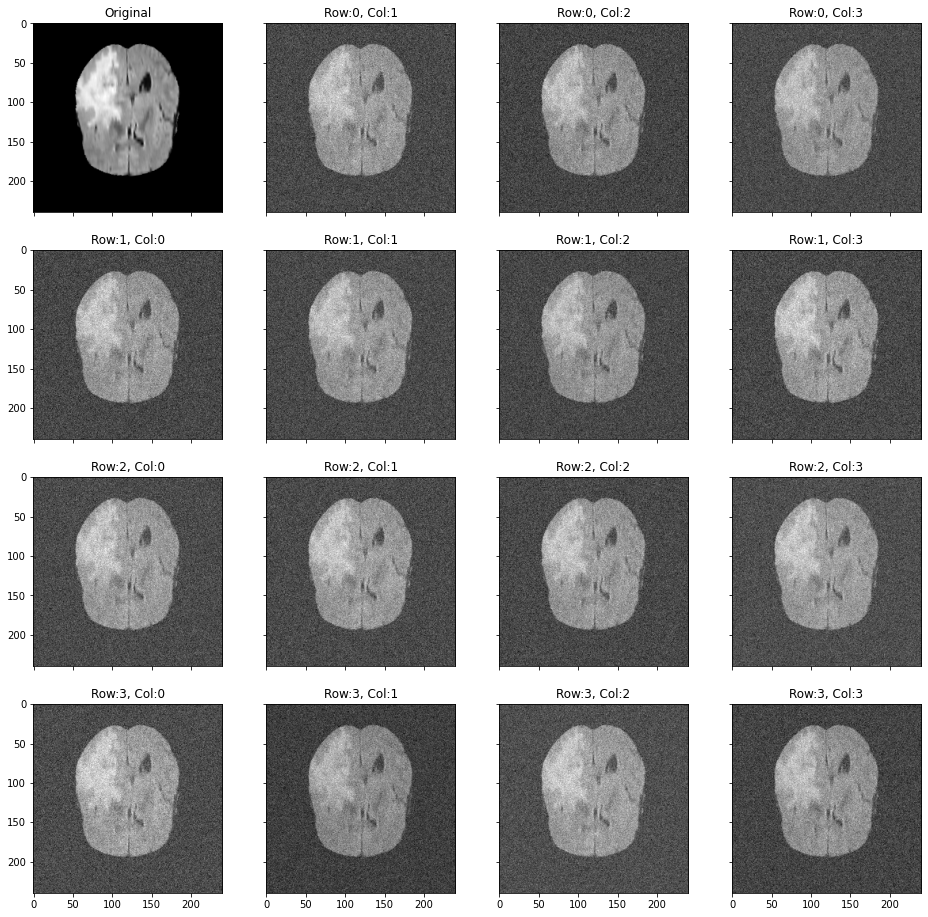

In [83]:
k=15
noised = []
for i in range(k):
    random_noise = tio.RandomNoise(std=0.5)
    noised.append(random_noise(standardize(sample)))

plot_k_transformed(sample, noised, figsize=(16,16))

## Random bias field

Pre-transform:
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: LPS+; memory: 68.1 MiB; dtype: torch.ShortTensor)


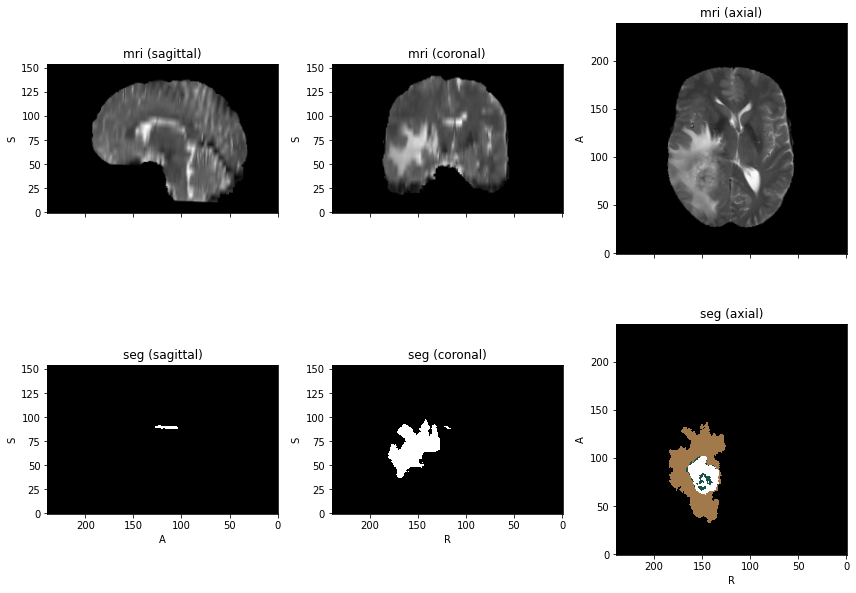

After transformation:
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: LPS+; memory: 136.2 MiB; dtype: torch.FloatTensor)


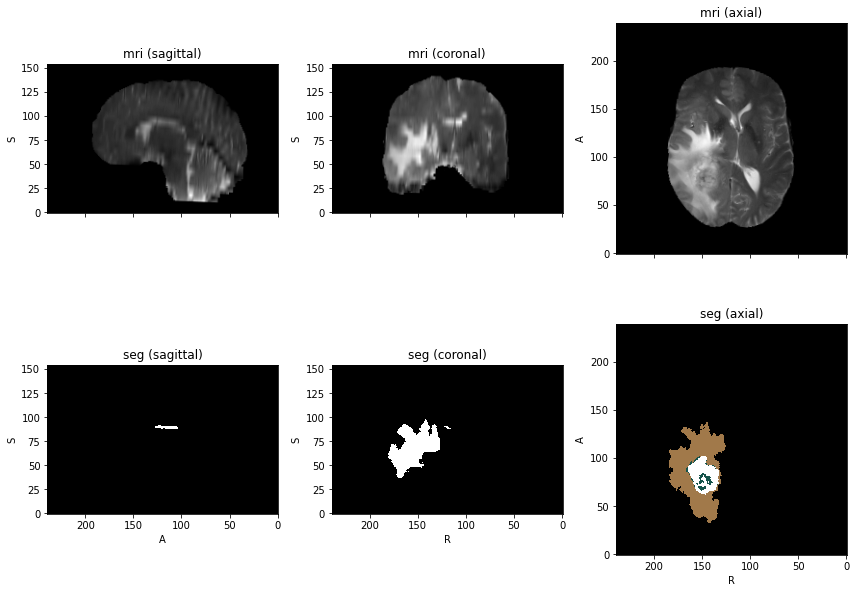

In [85]:
add_bias = tio.RandomBiasField(coefficients=1)
mni_bias = add_bias(sample)
plot_transform(sample, mni_bias)

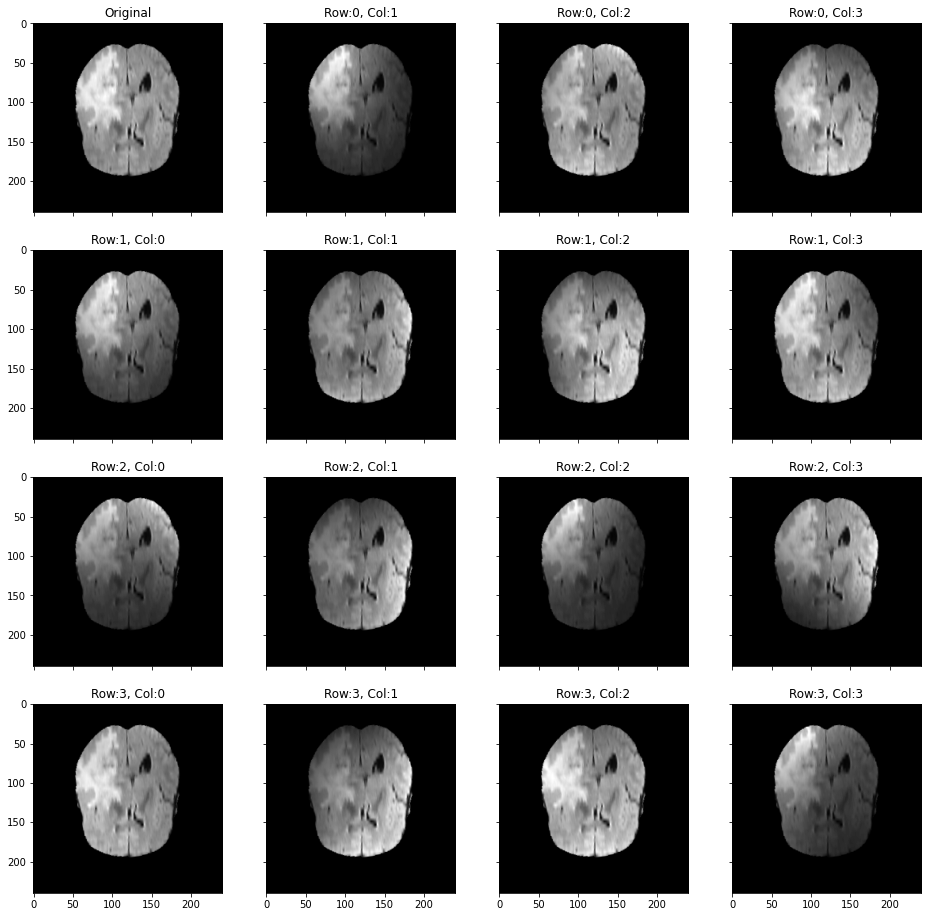

In [86]:
k=15
biased = []
for i in range(k):
    add_bias = tio.RandomBiasField(coefficients=1)
    biased.append(add_bias(sample))

plot_k_transformed(sample, biased, figsize=(16,16))

## Random spikes

Pre-transform:
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: LPS+; memory: 68.1 MiB; dtype: torch.ShortTensor)


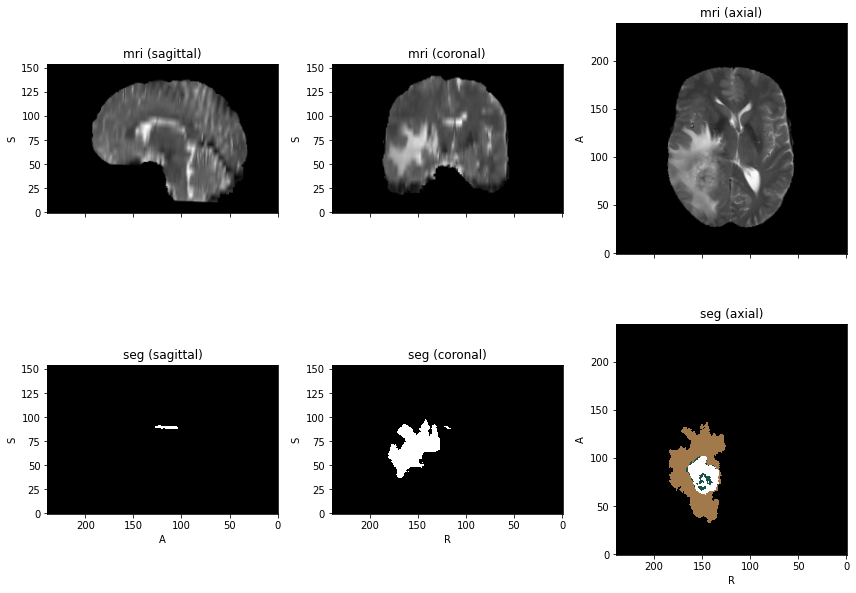

After transformation:
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: LPS+; memory: 136.2 MiB; dtype: torch.FloatTensor)


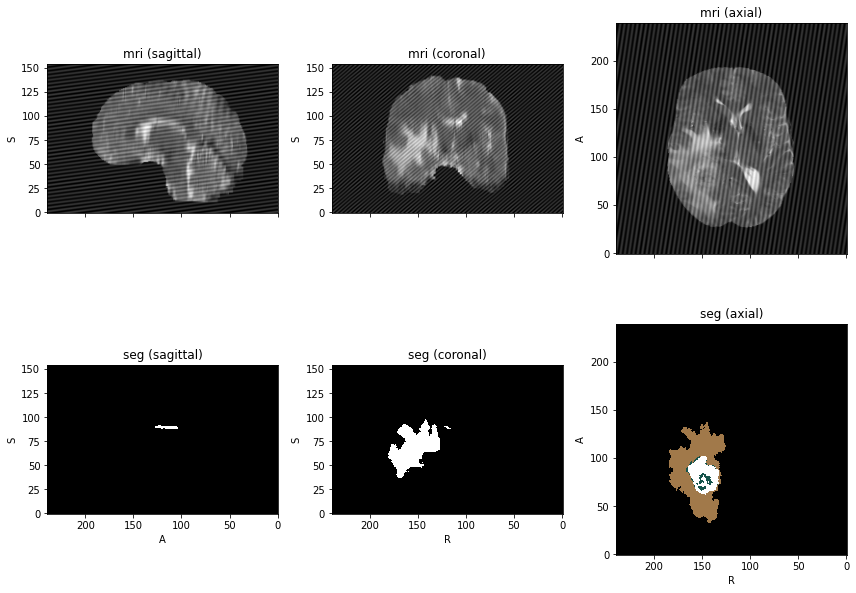

In [87]:
add_spike = tio.RandomSpike()
with_spike = add_spike(sample)

plot_transform(sample, with_spike)

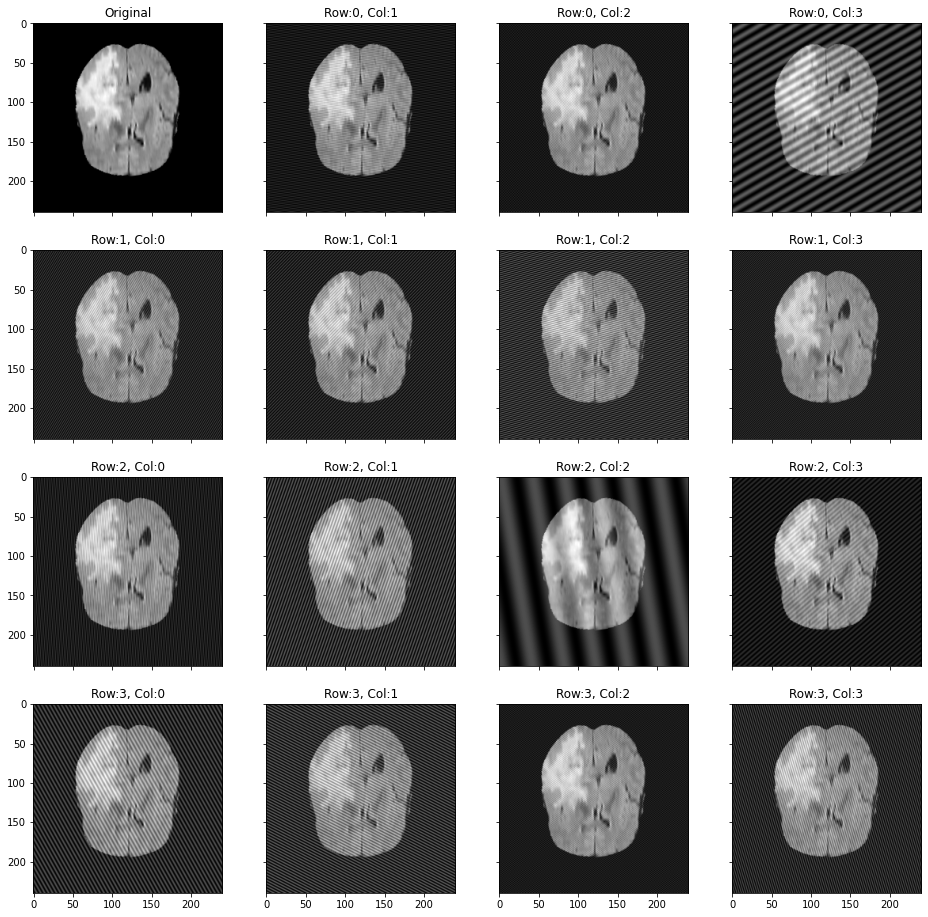

In [88]:
k=15
spiked = []
for i in range(k):
    add_spike = tio.RandomSpike()
    spiked.append(add_spike(sample))

plot_k_transformed(sample, spiked, figsize=(16,16))

## Random ghosting

In [71]:
add_ghosts = tio.RandomGhosting(intensity=1.5)
with_ghosts = add_ghosts(sample)

Pre-transform:
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: LPS+; memory: 136.2 MiB; dtype: torch.FloatTensor)


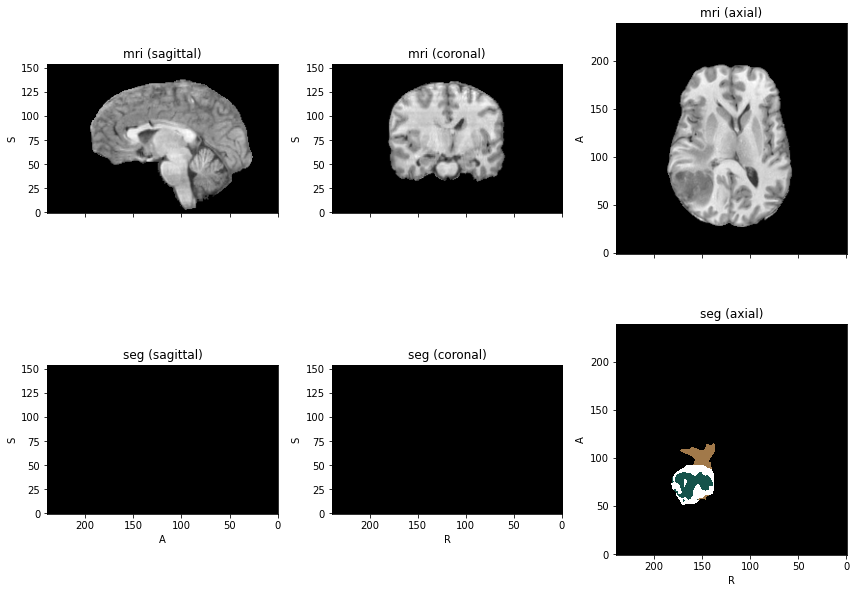

After transformation:
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: LPS+; memory: 136.2 MiB; dtype: torch.FloatTensor)


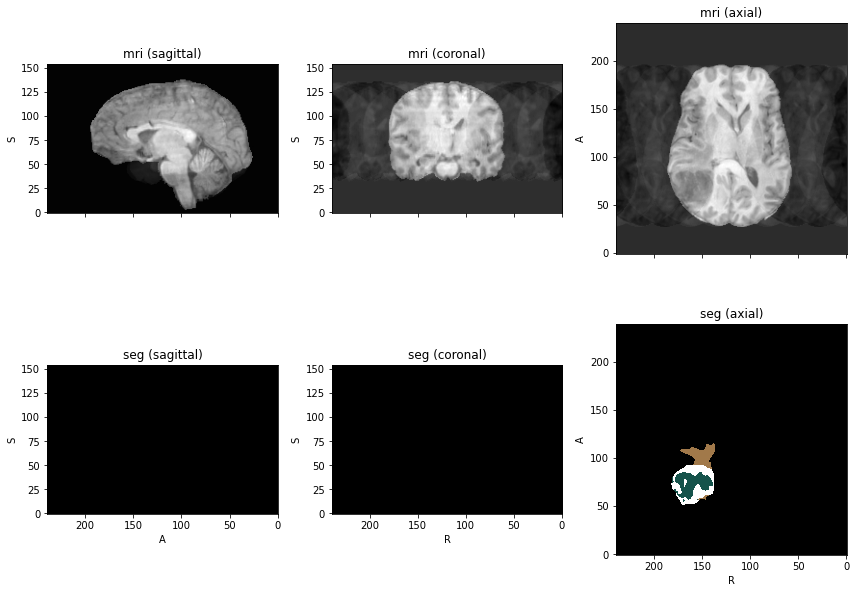

In [72]:
plot_transform(sample, with_ghosts)

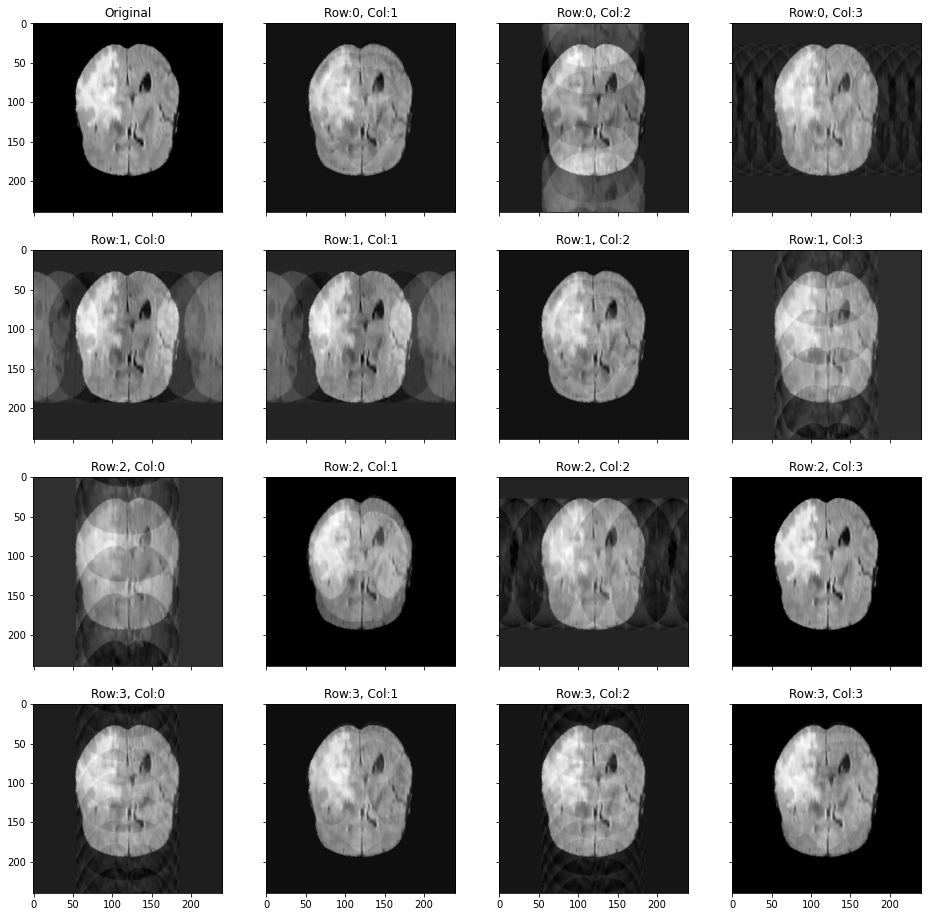

In [89]:
k=15
ghosted = []
for i in range(k):
    add_ghosts = tio.RandomGhosting(intensity=1.5)
    ghosted.append(add_ghosts(sample))

plot_k_transformed(sample, ghosted, figsize=(16,16))

## Random motion

In [73]:
add_motion = tio.RandomMotion(num_transforms=6, image_interpolation='nearest')
with_motion = add_motion(sample)

Pre-transform:
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: LPS+; memory: 136.2 MiB; dtype: torch.FloatTensor)


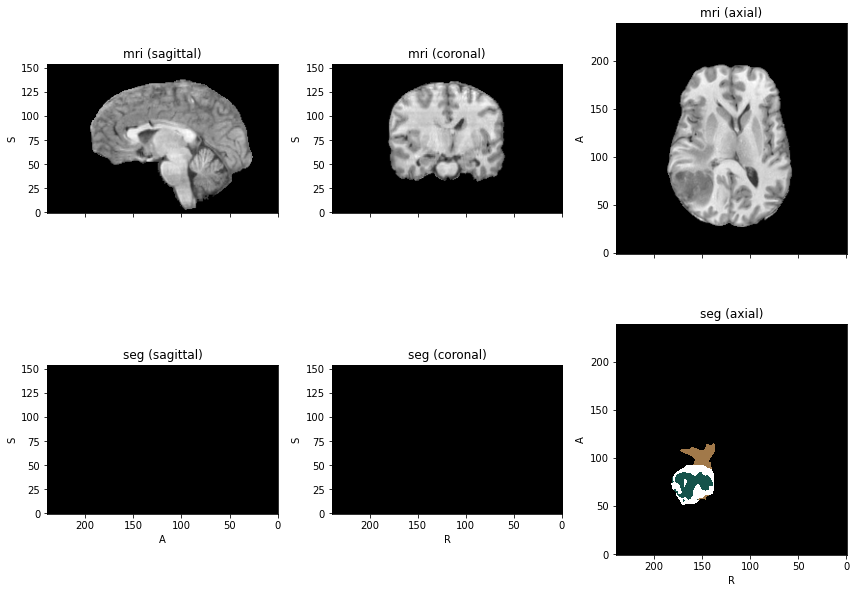

After transformation:
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: LPS+; memory: 136.2 MiB; dtype: torch.FloatTensor)


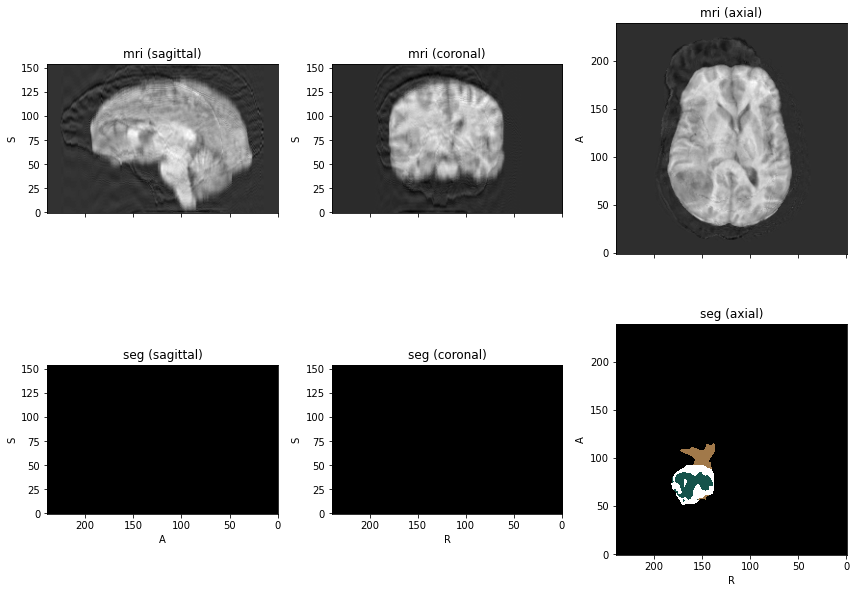

In [74]:
plot_transform(sample, with_motion)

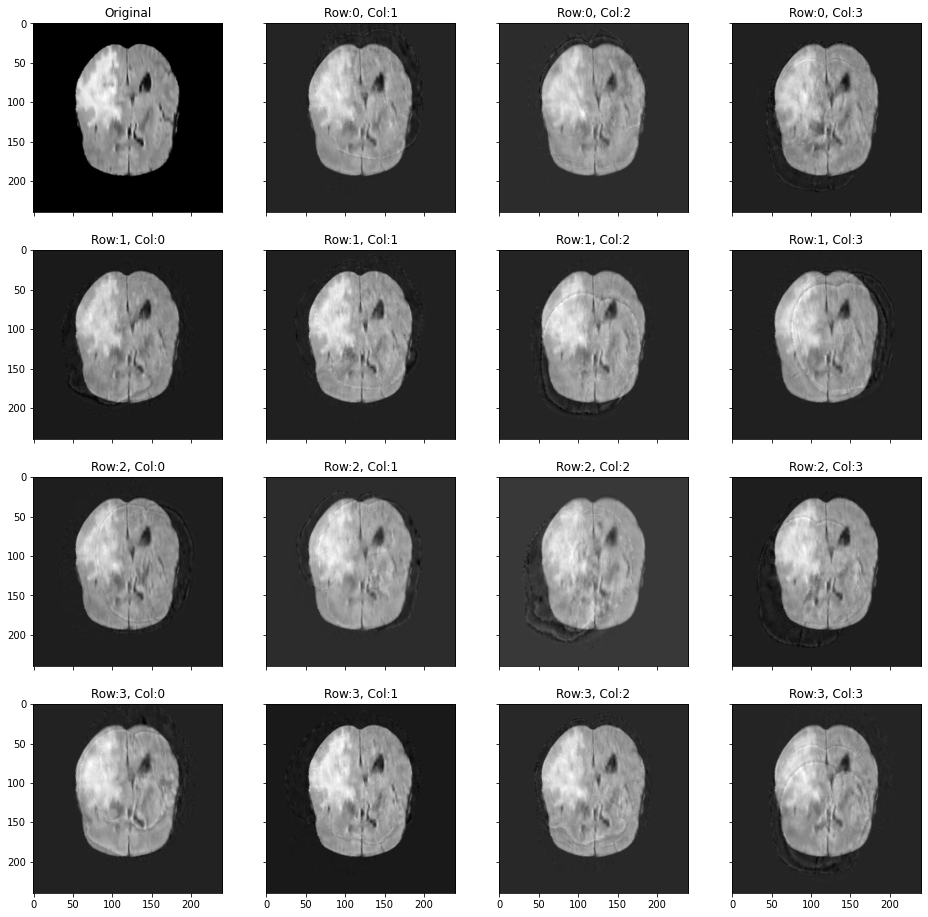

In [90]:
k=15
motioned = []
for i in range(k):
    add_motion = tio.RandomMotion(num_transforms=6, image_interpolation='nearest')
    motioned.append(add_motion(sample))

plot_k_transformed(sample, motioned, figsize=(16,16))

## Simulating brain resections

[Pérez-García et al.](https://arxiv.org/abs/2006.15693) simulated brain resection cavities from healthy subjects to pre-train a segmentation model using self-supervised learning. We will first download and install the [`resector`](https://github.com/fepegar/resector) package.

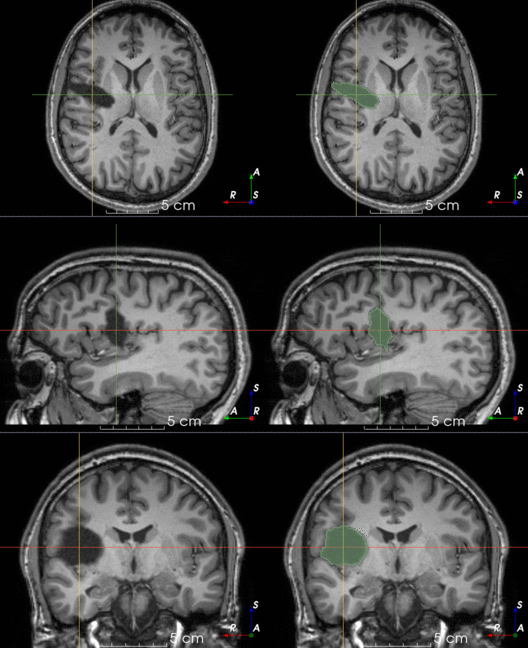

In [108]:
from IPython.display import Image
Image(filename='60_examples_resized_50.gif')

# Compose transformations

In [77]:
spatial_transform = tio.OneOf({
    tio.RandomAffine(): 0.75,
    tio.RandomElasticDeformation(): 0.25,
})

In [78]:
spatial_sample = spatial_transform(sample)

Pre-transform:
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: LPS+; memory: 136.2 MiB; dtype: torch.FloatTensor)


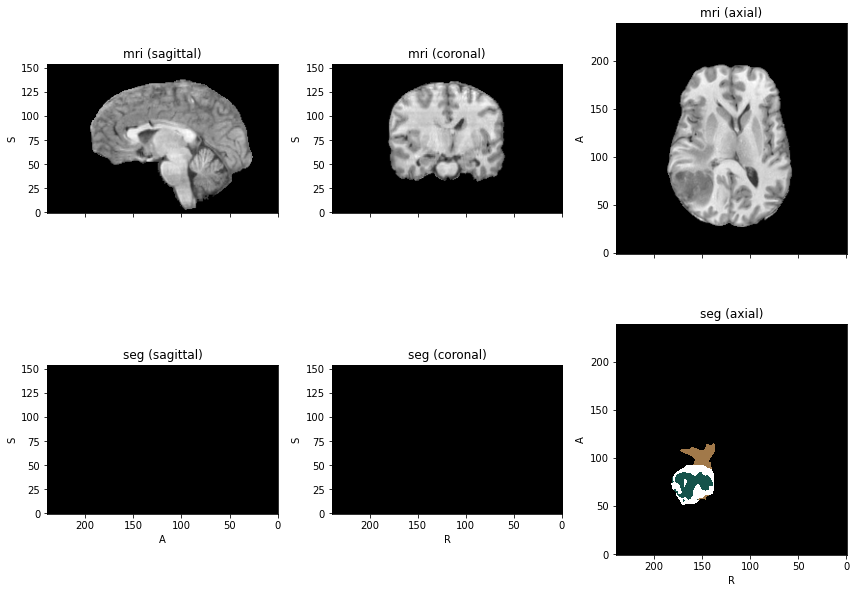

After transformation:
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: LPS+; memory: 136.2 MiB; dtype: torch.FloatTensor)


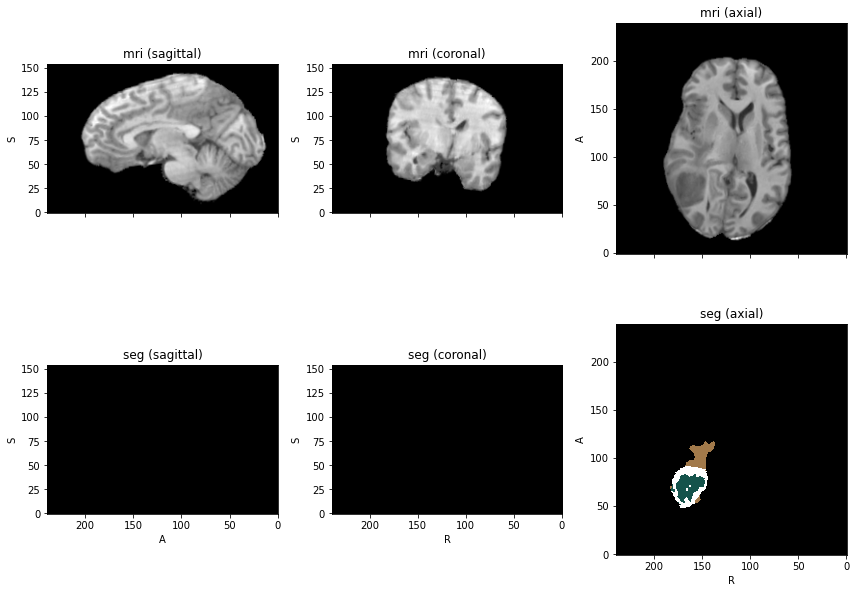

In [79]:
plot_transform(sample, spatial_sample)

In [117]:
get_foreground = tio.ZNormalization.mean

training_transform = tio.Compose([
    tio.RandomAnisotropy(p=0.25),              # make images look anisotropic 25% of times
    tio.ZNormalization(
        masking_method=get_foreground),        # zero mean, unit variance of foreground
    tio.RandomBlur(p=0.25),                    # blur 25% of times
    tio.RandomNoise(p=0.25),                   # Gaussian noise 25% of times
    tio.OneOf({                                # either
        tio.RandomAffine(): 0.8,               # random affine
        tio.RandomElasticDeformation(): 0.2,   # or random elastic deformation
    }, p=0.8),                                 # applied to 80% of images
    tio.RandomBiasField(p=0.3),                # magnetic field inhomogeneity 30% of times
    tio.OneOf({                                # either
        tio.RandomMotion(): 1,                 # random motion artifact
        tio.RandomSpike(): 2,                  # or spikes
        tio.RandomGhosting(): 2,               # or ghosts
    }, p=0.5),                                 # applied to 50% of images
])


In [118]:
transformed = training_transform(sample)

Pre-transform:
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: LPS+; memory: 68.1 MiB; dtype: torch.ShortTensor)


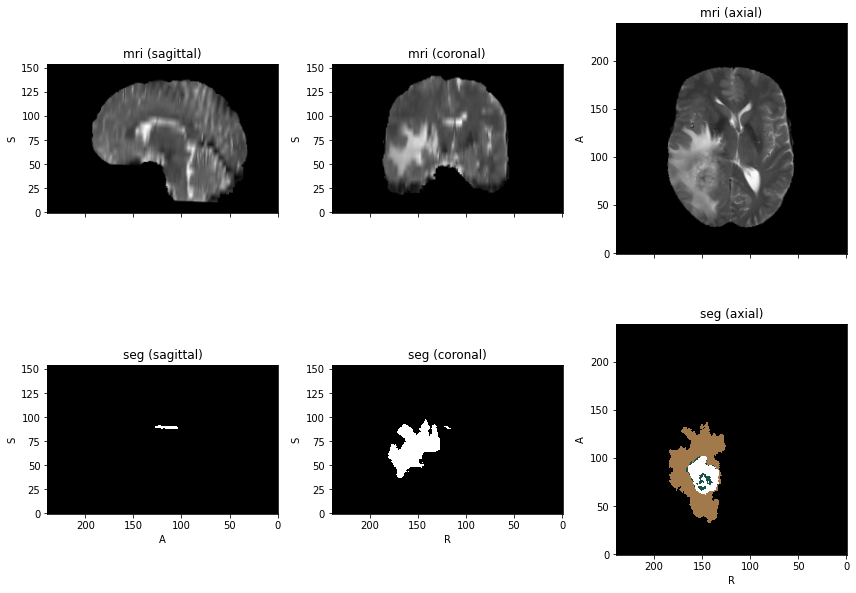

After transformation:
ScalarImage(shape: (4, 240, 240, 155); spacing: (1.00, 1.00, 1.00); orientation: LPS+; memory: 136.2 MiB; dtype: torch.FloatTensor)


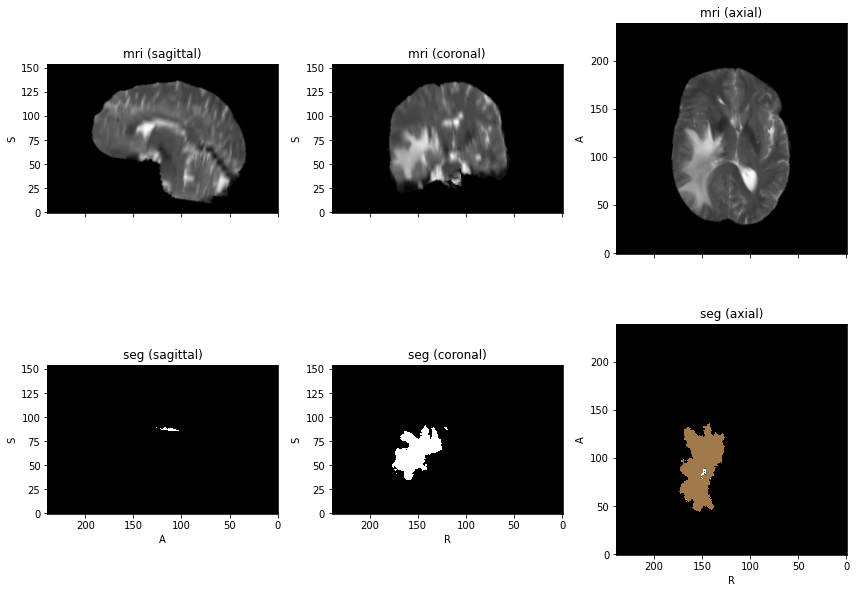

In [119]:
plot_transform(sample, transformed)